<a href="https://colab.research.google.com/github/jmestanza/computer-vision-2/blob/main/tp_vpc2_yolo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Trabajo práctico integrador de Visión por Computadora 2
Autor: Joaquín Mestanza

N° SIU: a1726

## Problema a resolver

Detección de vehículos con imágenes en plano cenital

## Contexto y restricciones

Las imágenes son tomadas por un drone desde un plano cenital.

Las imágenes son RGB y son de alta resolución (3024x4032 pixeles, height x width).

No siempre hay vehículos ni personas en las instalaciones, de hecho es algo poco frecuente.

## Datasets candidatos

- [Dataset 1] https://universe.roboflow.com/wictronix-ubfrb/atlanz_wx-wthzi

- [Dataset 2] https://universe.roboflow.com/sardar-vallabhbhai-national-institute-if-technology/vehicle-detection-wagr7

- [Dataset 3] https://universe.roboflow.com/roy15957-gmail-com/object-detection-from-drone

Se tuvo en cuenta como primer filtro para la elección de datasets, que tengan al menos 1000 imágenes.
Los 3 dataset incluyen detección de autos, pero el tercero incluye personas también.

## Proceso

Antes de entrenar, debemos tener en cuenta con qué vamos a evaluar.
De ahí salen las siguientes preguntas:

### Entrenamiento
- Vamos a entrenar (train+validation) con
  - Los datasets de roboflow? (3.7k y 1.5k imágenes etiquetadas)

  o
  - Un dataset armado por nosotros? (que implica un etiquetado previo... 1000 imágenes al menos?)
### Testing
- Vamos a evaluar con (test)
  - Los datasets de roboflow? (al menos 100 imágenes)

  y / o
  - Un dataset armado por nosotros? (implica un subset etiquetado, al menos de 100 imágenes)

Algo a tener en cuenta es que cuando probemos con las imágenes en las inspecciones, el terreno es bastante distinto al de las imágenes de roboflow, por lo cual es posible que haya un decaimiento en la performance.
### Métricas a utilizar

La métrica a utilizar es la mAP (mean average precision).

Esta métrica depende de:
- La confianza p de que existe un objeto sea mayor a cierto umbral (> 80%, por ejemplo).
- Que la clase predicha sea la correcta
- Que la IoU del bounding box predicho y el ground truth sea mayor a un umbral predicho (> 50%, por ejemplo).

Hay que tener en consideración que al modificar los valores umbrales de IoU y confianza, cambia nuestra definición de TP (True Positive), FN (False negative), FP (False positive) y TN (True Negative), dando posibles mejores resultados de los que realmente presenta nuestro modelo.


## Utilidades

Query para obtener las imágenes en plano cenital:
```sql
SELECT
	*
FROM
	IMAGE
WHERE
	"missionId" = 'mission_uuid'
	AND (DATA -> 'metadata' -> 'gimbal' ->> 'pitch')::NUMERIC > -(90+10) -- (-90) grados +/- 10
	AND (DATA -> 'metadata' -> 'gimbal' ->> 'pitch')::NUMERIC < -(90-10)
ORDER BY
	CREATED_AT DESC
LIMIT
	100;
```

In [1]:
# !pip install torch torchvision torchaudio
# !pip install 'git+https://github.com/facebookresearch/detectron2.git'
!pip install ultralytics


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 981.3/981.3 kB 23.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 117.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 94.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 55.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 89.4 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstal

Generamos un token para poder subir la info de las runs a Github.

In [2]:
import os
from getpass import getpass
if not os.path.exists('github_pat.txt'):
  github_pat = getpass()
  with open('github_pat.txt', 'w+') as f:
    f.write(github_pat)
else:
  with open('github_pat.txt', 'r') as f:
    github_pat = f.read()

··········


## Descarga de dataset

In [3]:
import os
if not os.path.exists('dataset'):
  !curl -L "https://universe.roboflow.com/ds/oXYyTH2btN?key=NM3Z7u9aVZ" > roboflow.zip; echo "Unzipping..."; mkdir dataset; unzip -q roboflow.zip -d dataset; rm roboflow.zip; echo "Completed successfully."

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   903  100   903    0     0   3167      0 --:--:-- --:--:-- --:--:--  3179
100  423M  100  423M    0     0  57.2M      0  0:00:07  0:00:07 --:--:-- 55.7M
Unzipping...
Completed successfully.


In [4]:
!cat /content/dataset/data.yaml

train: ../train/images
val: ../valid/images
test: ../test/images

nc: 14
names: ['bu5', 'c4r', 'consV3h', 'motorbik3', 'p3rson', 'tr2ck', 'tr4ck', 'v3hicle', 'vai', 'vai_false', 'vai_true', 'vap', 'vap_false', 'vap_true']

roboflow:
  workspace: roy15957-gmail-com
  project: object-detection-from-drone
  version: 2
  license: Private
  url: https://universe.roboflow.com/roy15957-gmail-com/object-detection-from-drone/dataset/2

In [5]:
new_yaml="""train: /content/dataset/train/images
val: /content/dataset/valid/images

nc: 14
names: ['bu5', 'c4r', 'consV3h', 'motorbik3', 'p3rson', 'tr2ck', 'tr4ck', 'v3hicle', 'vai', 'vai_false', 'vai_true', 'vap', 'vap_false', 'vap_true']
"""
with open("dataset/new_data.yaml", "w") as f:
  f.write(new_yaml)

In [6]:
!cat /content/dataset/new_data.yaml

train: /content/dataset/train/images
val: /content/dataset/valid/images

nc: 14
names: ['bu5', 'c4r', 'consV3h', 'motorbik3', 'p3rson', 'tr2ck', 'tr4ck', 'v3hicle', 'vai', 'vai_false', 'vai_true', 'vap', 'vap_false', 'vap_true']


In [7]:
import os
from pathlib import Path

# --- config ---
dataset_root = Path("/content/dataset")
splits = ["train", "valid"]

# original class names in order (same as in new_data.yaml)
original_names = ['bu5', 'c4r', 'consV3h', 'motorbik3', 'p3rson', 'tr2ck', 'tr4ck', 'v3hicle', 'vai', 'vai_false', 'vai_true', 'vap', 'vap_false', 'vap_true']

# keyword groups
person_keywords = {"p3rson"}
vehicle_keywords = {"bu5", "c4r", "consV3h", "motorbik3", "tr2ck", "tr4ck", "v3hicle"}

# Create mapping from original class index to new class index or None (to ignore)
remap_dict = {}
for idx, name in enumerate(original_names):
    if name in person_keywords:
        remap_dict[idx] = 0  # person
    elif name in vehicle_keywords:
        remap_dict[idx] = 1  # vehicle
    else:
        remap_dict[idx] = None  # ignore

# --- process each label file ---
for split in splits:
    label_dir = dataset_root / split / "labels"
    for label_path in label_dir.glob("*.txt"):
        new_lines = []
        with open(label_path, "r") as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) != 5:
                    continue  # skip malformed lines
                class_id = int(parts[0])
                new_class = remap_dict.get(class_id)
                if new_class is not None:
                    new_line = f"{new_class} {' '.join(parts[1:])}"
                    new_lines.append(new_line)
        # Overwrite with filtered and remapped labels
        with open(label_path, "w") as f:
            f.write("\n".join(new_lines) + "\n" if new_lines else "")


In [8]:
new_yaml="""train: /content/dataset/train/images
val: /content/dataset/valid/images

nc: 2
names: ['person', 'vehicle']
"""
with open("dataset/new_data.yaml", "w") as f:
  f.write(new_yaml)

Showing images for class: person


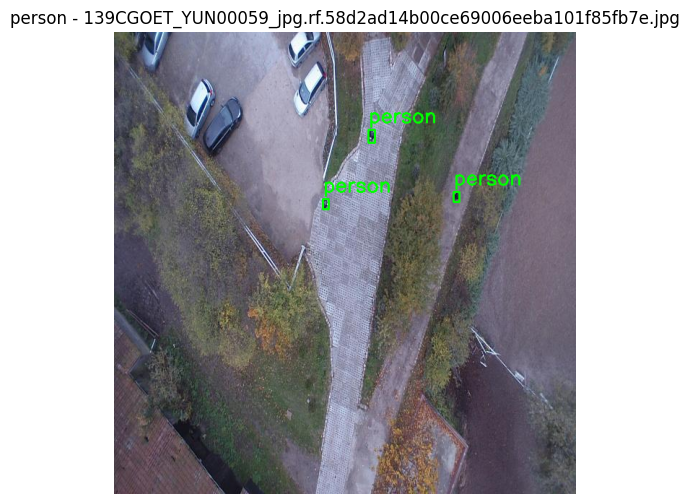

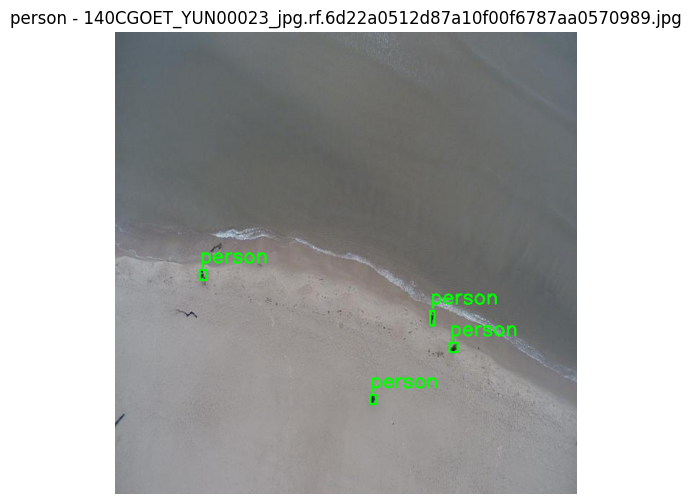

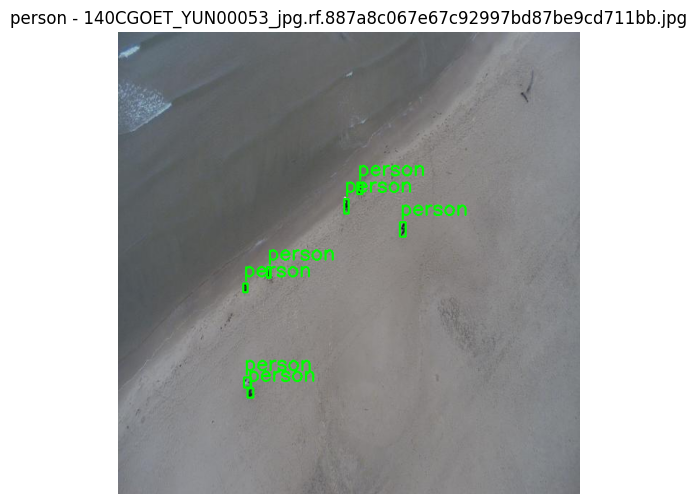

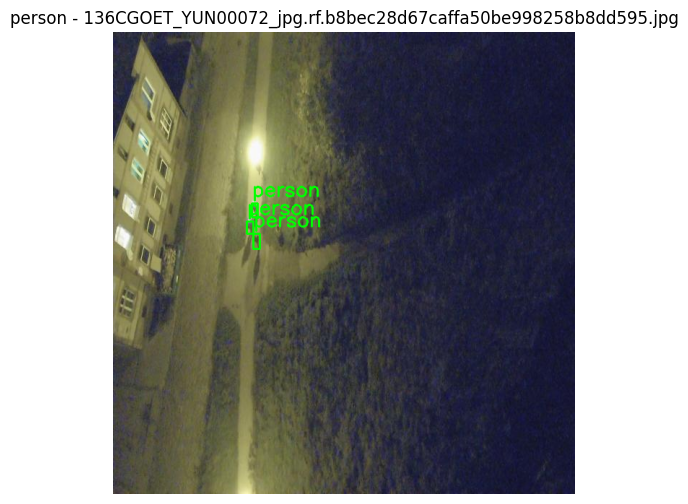

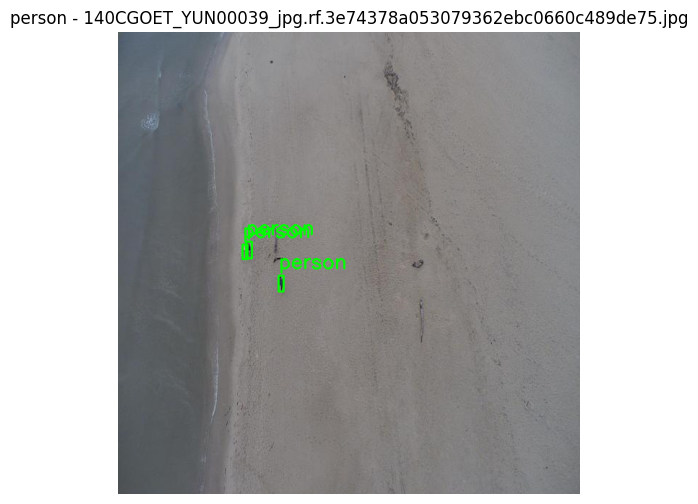

Showing images for class: vehicle


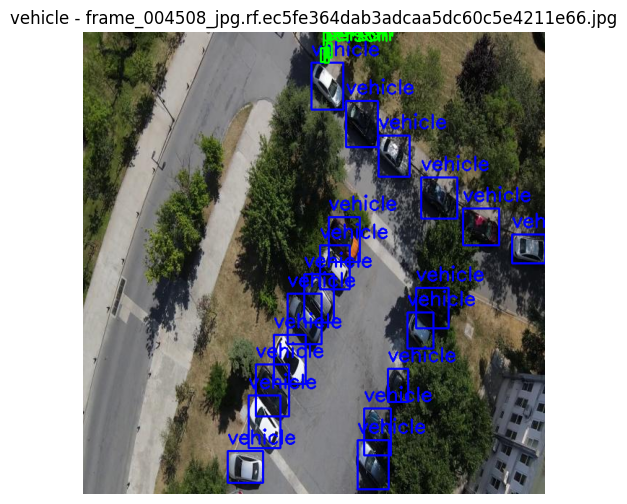

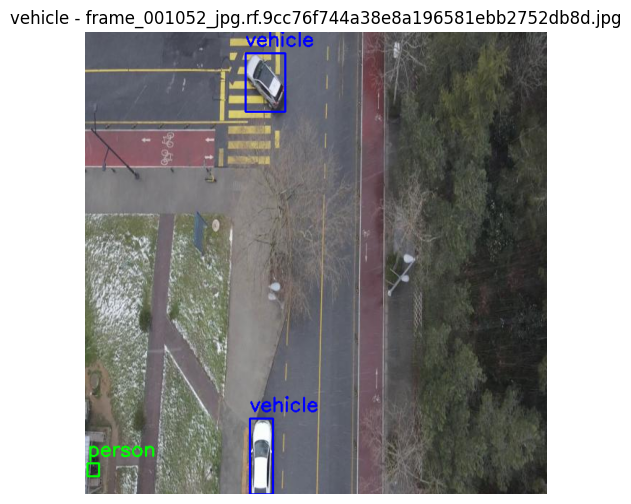

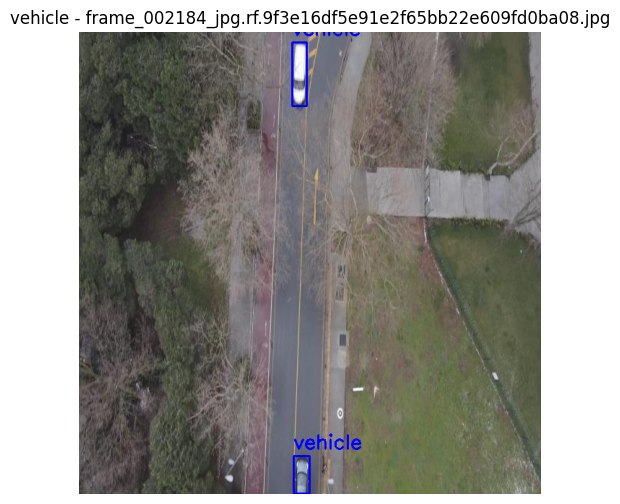

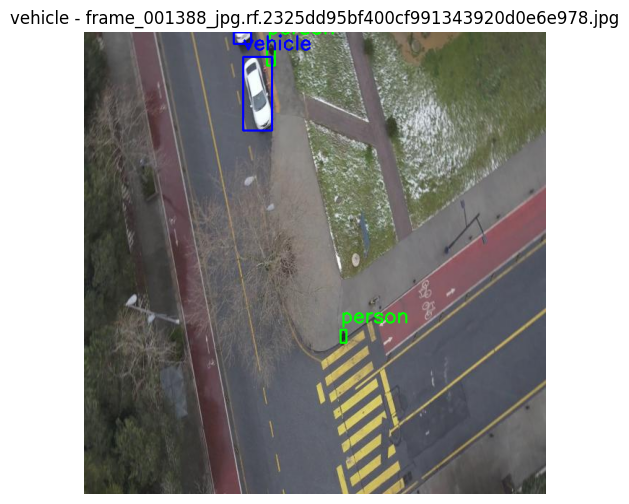

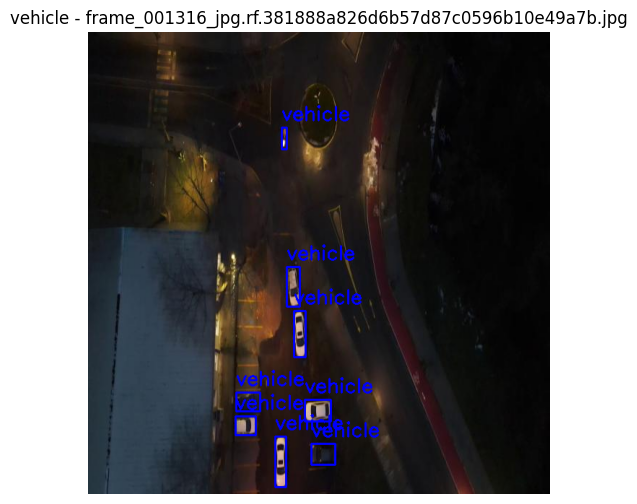

In [9]:
import cv2
import matplotlib.pyplot as plt
from pathlib import Path
from collections import defaultdict

# --- Setup ---
data_root = Path("/content/dataset/valid")
image_dir = data_root / "images"
label_dir = data_root / "labels"
class_names = ['person', 'vehicle']
images_per_class = 5

# --- Collect images with at least one object of each class ---
class_to_images = defaultdict(list)

for label_path in label_dir.glob("*.txt"):
    with open(label_path) as f:
        lines = f.readlines()
        found_classes = set(int(line.split()[0]) for line in lines if line.strip())
    for cls in found_classes:
        if cls in [0, 1] and len(class_to_images[cls]) < images_per_class:
            class_to_images[cls].append(label_path.stem)

# --- Visualization ---
for cls_id, image_names in class_to_images.items():
    print(f"Showing images for class: {class_names[cls_id]}")
    for name in image_names:
        image_path = image_dir / f"{name}.jpg"
        label_path = label_dir / f"{name}.txt"
        if not image_path.exists() or not label_path.exists():
            continue

        # Load image
        img = cv2.imread(str(image_path))
        h, w = img.shape[:2]

        # Draw bounding boxes
        with open(label_path) as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) != 5:
                    continue
                class_id, x, y, bw, bh = map(float, parts)
                class_id = int(class_id)
                cx, cy, bw, bh = x * w, y * h, bw * w, bh * h
                x1, y1 = int(cx - bw / 2), int(cy - bh / 2)
                x2, y2 = int(cx + bw / 2), int(cy + bh / 2)
                color = (0, 255, 0) if class_id == 0 else (255, 0, 0)
                cv2.rectangle(img, (x1, y1), (x2, y2), color, 2)
                cv2.putText(img, class_names[class_id], (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)

        # Display
        plt.figure(figsize=(8, 6))
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.title(f"{class_names[cls_id]} - {image_path.name}")
        plt.show()


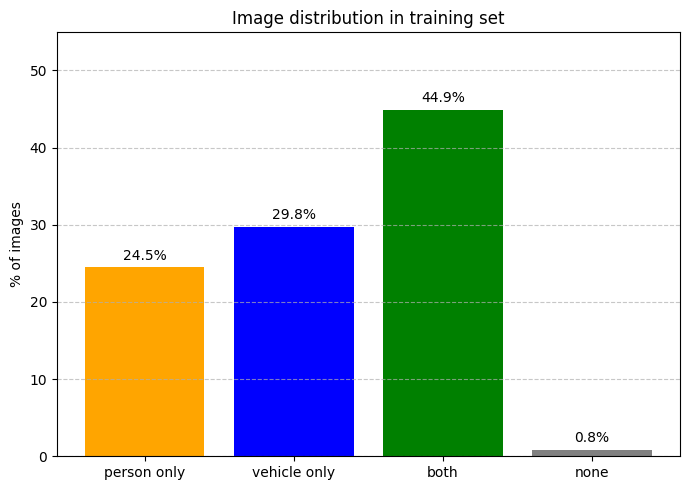

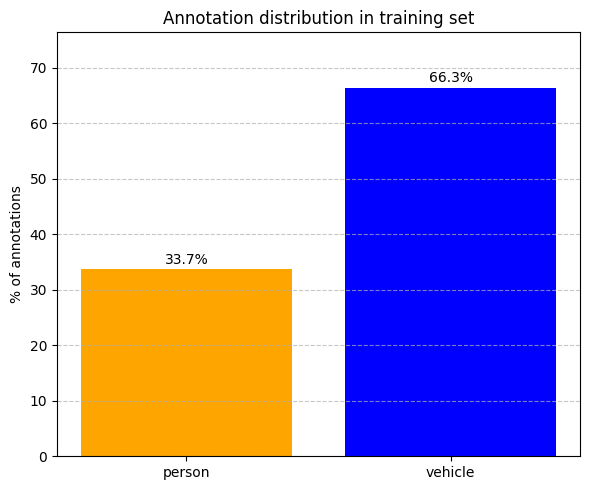

Total images: 5175
Images with no person or vehicle annotations: 43 (0.83%)


In [15]:
import matplotlib.pyplot as plt
from pathlib import Path

# Directory containing label files
label_dir = Path("/content/dataset/train/labels")

# Counters for image-level statistics
image_count = {'person': 0, 'vehicle': 0, 'both': 0, 'none': 0}
# Counters for annotation-level statistics
annotation_count = {'person': 0, 'vehicle': 0}
total_images = 0

# Iterate over all label files
for label_file in label_dir.glob("*.txt"):
    with open(label_file) as f:
        lines = [line.strip() for line in f if line.strip()]
    total_images += 1
    has_person = False
    has_vehicle = False

    for line in lines:
        class_id = int(line.split()[0])
        if class_id == 0:
            has_person = True
            annotation_count['person'] += 1
        elif class_id == 1:
            has_vehicle = True
            annotation_count['vehicle'] += 1

    if has_person and has_vehicle:
        image_count['both'] += 1
    elif has_person:
        image_count['person'] += 1
    elif has_vehicle:
        image_count['vehicle'] += 1
    else:
        image_count['none'] += 1

# --- Plot image-level distribution ---
img_labels = ['person only', 'vehicle only', 'both', 'none']
img_values = [
    image_count['person'],
    image_count['vehicle'],
    image_count['both'],
    image_count['none']
]
img_percentages = [v / total_images * 100 for v in img_values]

plt.figure(figsize=(7, 5))
plt.bar(img_labels, img_percentages, color=['orange', 'blue', 'green', 'gray'])
plt.ylabel('% of images')
plt.title('Image distribution in training set')
for i, v in enumerate(img_percentages):
    plt.text(i, v + 1, f"{v:.1f}%", ha='center')
plt.ylim(0, max(img_percentages) + 10)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

# --- Plot annotation-level distribution ---
ann_labels = ['person', 'vehicle']
ann_values = [annotation_count['person'], annotation_count['vehicle']]
ann_total = sum(ann_values)
ann_percentages = [v / ann_total * 100 for v in ann_values] if ann_total > 0 else [0, 0]

plt.figure(figsize=(6, 5))
plt.bar(ann_labels, ann_percentages, color=['orange', 'blue'])
plt.ylabel('% of annotations')
plt.title('Annotation distribution in training set')
for i, v in enumerate(ann_percentages):
    plt.text(i, v + 1, f"{v:.1f}%", ha='center')
plt.ylim(0, max(ann_percentages) + 10)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

# --- Print summary ---
none_percentage = image_count['none'] / total_images * 100
print(f"Total images: {total_images}")
print(f"Images with no person or vehicle annotations: {image_count['none']} ({none_percentage:.2f}%)")


## Imágenes donde no hay ni vehículos ni personas

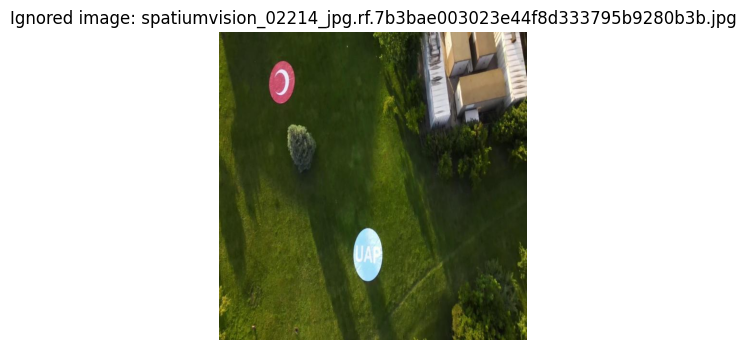

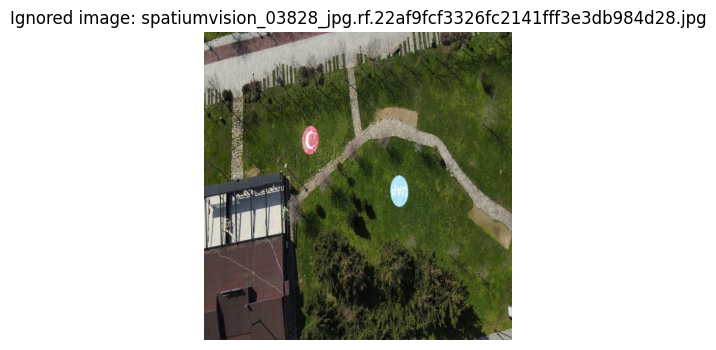

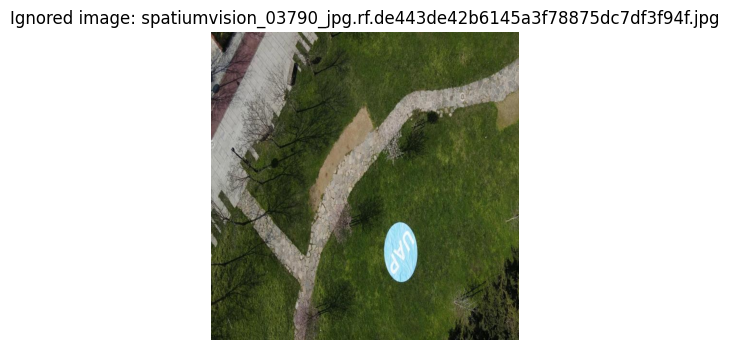

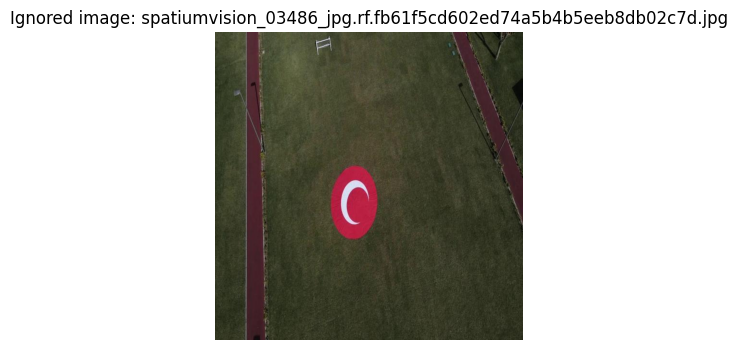

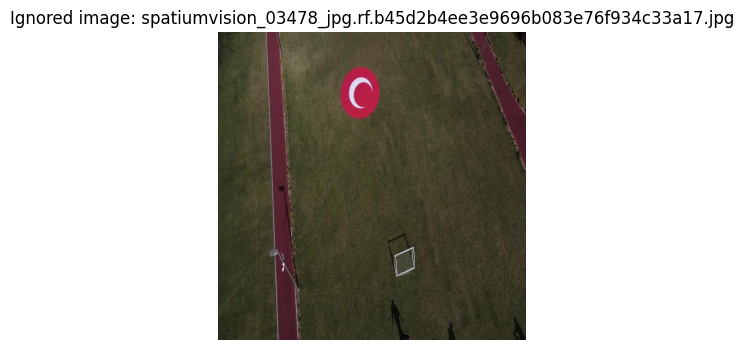

In [11]:
import cv2
import matplotlib.pyplot as plt
from pathlib import Path

image_dir = Path("/content/dataset/train/images")
label_dir = Path("/content/dataset/train/labels")

ignored_images = []

for label_path in label_dir.glob("*.txt"):
    with open(label_path) as f:
        lines = [line.strip() for line in f if line.strip()]

    only_ignored = all(int(line.split()[0]) not in (0, 1) for line in lines) if lines else True

    if only_ignored:
        img_path = image_dir / f"{label_path.stem}.jpg"
        if img_path.exists():
            ignored_images.append(img_path)
        if len(ignored_images) >= 5:
            break

# --- Show images ---
for img_path in ignored_images:
    img = cv2.imread(str(img_path))
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(6, 4))
    plt.imshow(img_rgb)
    plt.axis('off')
    plt.title(f"Ignored image: {img_path.name}")
    plt.show()


In [12]:
import os

repo_path = '/content/computer-vision-2'
if not os.path.exists(repo_path):
  print('Repo not downloaded yet.')
  !git clone https://{github_pat}@github.com/jmestanza/computer-vision-2.git
else:
  print('Repo available.')

Repo not downloaded yet.
Cloning into 'computer-vision-2'...
remote: Enumerating objects: 622, done.
remote: Counting objects: 100% (160/160), done.
remote: Compressing objects: 100% (100/100), done.
remote: Total 622 (delta 106), reused 87 (delta 60), pack-reused 462 (from 1)
Receiving objects: 100% (622/622), 716.86 MiB | 32.37 MiB/s, done.
Resolving deltas: 100% (278/278), done.


In [13]:
import datetime
import uuid

if not os.path.exists(f'{repo_path}/runs'):
    os.makedirs(f'{repo_path}/runs')
    print('Directory created.')
else:
    print('Directory already exists.')

run_id = str(uuid.uuid4())
print("run_id: ", run_id)
run_id_folder = f"run_id_{run_id}"

if not os.path.exists(f'{repo_path}/runs/{run_id_folder}'):
    os.makedirs(f'{repo_path}/runs/{run_id_folder}')
    print('Directory created.')
else:
    print('Directory already exists.')

Directory already exists.
run_id:  cfc4d50f-3a50-42c3-a3a6-45c37c95a7db
Directory created.


In [14]:
from ultralytics import YOLO
import os
import json
import os

cache_dir = "/content/dataset"
for cache_file in ["train.cache", "valid.cache"]:
    cache_path = os.path.join(cache_dir, cache_file)
    if os.path.exists(cache_path):
        os.remove(cache_path)
        print(f"Deleted {cache_path}")

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [17]:
pip install -U albumentations


In [24]:
import albumentations
print(albumentations.__version__)


2.0.5


In [26]:
import numpy as np
import albumentations as A
from ultralytics.data.augment import Albumentations
from ultralytics import YOLO

# # Define person-focused albumentation
# class PersonFocusedAlbumentation:
#     def __init__(self, p=0.7):
#         self.aug = A.Compose([
#             A.RandomBrightnessContrast(p=0.5),
#             A.HueSaturationValue(p=0.5),
#             A.Rotate(limit=15, p=0.5),
#             A.RandomScale(scale_limit=0.3, p=0.5),
#             A.CoarseDropout(
#                 max_height=32,
#                 max_width=32,
#                 min_height=16,
#                 min_width=16,
#                 p=0.5
#             )
#         ], bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))
#         self.p = p

#     def __call__(self, im, labels):
#         if labels is None or len(labels) == 0:
#             return im, labels
#         classes = labels[:, 0]
#         if 0 in classes and np.random.rand() < self.p:
#             bboxes = labels[:, 1:]
#             class_labels = labels[:, 0].astype(int).tolist()
#             augmented = self.aug(image=im, bboxes=bboxes, class_labels=class_labels)
#             im = augmented['image']
#             labels = np.column_stack([augmented['class_labels'], augmented['bboxes']])
#         return im, labels

# # Register it with Albumentations wrapper
# custom_aug = Albumentations(PersonFocusedAlbumentation())

# Train model
model = YOLO('yolov8s.yaml')
model.train(
    data='/content/dataset/new_data.yaml',
    epochs=30,
    imgsz=640,
    batch=16,
    name='yolo_person_vehicle',
    project='./runs',
    device=0,
    workers=2,
    optimizer='SGD',
    lr0=0.001,
    warmup_epochs=3,
    cos_lr=True,
    weight_decay=0.0005,
    patience=20,
    val=True,
    augment=True  # ✅ must set this True
    tensorboard=True
)


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


<ipython-input-26-b4e9fc5ff6ae>:14: UserWarning: Argument(s) 'max_height, max_width, min_height, min_width' are not valid for transform CoarseDropout
  A.CoarseDropout(


Ultralytics 8.3.112 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.yaml, data=/content/dataset/new_data.yaml, epochs=30, time=None, patience=20, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=2, project=./runs, name=yolo_person_vehicle, exist_ok=False, pretrained=True, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=Tr

100%|██████████| 755k/755k [00:00<00:00, 21.8MB/s]

Overriding model.yaml nc=80 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics

YOLOv8s summary: 129 layers, 11,136,374 parameters, 11,136,358 gradients, 28.6 GFLOPs

Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...


100%|██████████| 5.35M/5.35M [00:00<00:00, 104MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1472.2±753.2 MB/s, size: 75.0 KB)


train: Scanning /content/dataset/train/labels... 5175 images, 43 backgrounds, 0 corrupt: 100%|██████████| 5175/5175 [00:02<00:00, 2375.31it/s]


train: New cache created: /content/dataset/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 801.0±251.1 MB/s, size: 53.7 KB)


val: Scanning /content/dataset/valid/labels... 1248 images, 16 backgrounds, 0 corrupt: 100%|██████████| 1248/1248 [00:01<00:00, 1120.39it/s]

val: New cache created: /content/dataset/valid/labels.cache


Plotting labels to runs/yolo_person_vehicle/labels.jpg... 
optimizer: SGD(lr=0.001, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/yolo_person_vehicle
Starting training for 30 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/30      5.82G      4.625      3.755      3.224        152        640: 100%|██████████| 324/324 [01:44<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:17<00:00,  2.20it/s]


                   all       1248       6414      0.526     0.0544     0.0107    0.00217

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/30      6.46G      4.105      3.043      2.647        125        640: 100%|██████████| 324/324 [01:40<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:13<00:00,  2.95it/s]


                   all       1248       6414      0.539     0.0815     0.0285    0.00846

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/30      6.48G       3.27      2.458      2.194        223        640: 100%|██████████| 324/324 [01:40<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:13<00:00,  3.00it/s]


                   all       1248       6414      0.288      0.249      0.137     0.0419

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/30       8.1G      2.554      1.919      1.758        395        640: 100%|██████████| 324/324 [01:39<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.05it/s]


                   all       1248       6414      0.556      0.318      0.352       0.16

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/30      4.66G      2.198       1.63      1.536        135        640: 100%|██████████| 324/324 [01:41<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.10it/s]

                   all       1248       6414      0.594      0.373      0.396      0.203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/30      7.52G      2.032       1.48      1.425        120        640: 100%|██████████| 324/324 [01:39<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:13<00:00,  3.00it/s]


                   all       1248       6414      0.588      0.406      0.428       0.23

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/30      5.69G      1.921      1.389      1.367        124        640: 100%|██████████| 324/324 [01:39<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.08it/s]

                   all       1248       6414      0.627      0.421      0.445      0.233



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/30      6.23G      1.836       1.32      1.325        310        640: 100%|██████████| 324/324 [01:39<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.09it/s]

                   all       1248       6414      0.618      0.451      0.482      0.268



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/30      6.26G      1.785      1.276      1.298        173        640: 100%|██████████| 324/324 [01:39<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.09it/s]


                   all       1248       6414      0.577      0.461      0.463      0.252

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/30      6.28G      1.727       1.22       1.27        147        640: 100%|██████████| 324/324 [01:40<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.06it/s]


                   all       1248       6414      0.541      0.461      0.452      0.257

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/30       6.3G      1.676      1.172      1.235        130        640: 100%|██████████| 324/324 [01:39<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.06it/s]

                   all       1248       6414      0.526      0.481      0.446      0.252



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/30      6.94G      1.661      1.155      1.227        133        640: 100%|██████████| 324/324 [01:40<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.09it/s]

                   all       1248       6414      0.571      0.472      0.461      0.263



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/30      6.96G      1.629       1.13      1.218        301        640: 100%|██████████| 324/324 [01:40<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.09it/s]

                   all       1248       6414      0.558        0.5      0.484       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/30       7.8G      1.609      1.107      1.206         46        640: 100%|██████████| 324/324 [01:39<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.09it/s]


                   all       1248       6414      0.574      0.492      0.467      0.271

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/30      5.79G      1.588      1.095      1.193         60        640: 100%|██████████| 324/324 [01:40<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.09it/s]

                   all       1248       6414      0.563       0.52      0.489      0.278



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/30      5.79G      1.578      1.083      1.192        126        640: 100%|██████████| 324/324 [01:40<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.08it/s]

                   all       1248       6414      0.549      0.529       0.49      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/30      5.79G      1.536      1.046       1.17        177        640: 100%|██████████| 324/324 [01:39<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.09it/s]

                   all       1248       6414      0.536      0.534      0.487      0.287



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/30      7.94G      1.543      1.049      1.173        213        640: 100%|██████████| 324/324 [01:39<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.08it/s]


                   all       1248       6414      0.567       0.54      0.495      0.285

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/30      5.71G      1.537      1.043      1.172        204        640: 100%|██████████| 324/324 [01:39<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.07it/s]

                   all       1248       6414      0.571      0.526        0.5      0.292



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/30      5.71G       1.52      1.024      1.164        128        640: 100%|██████████| 324/324 [01:40<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.10it/s]

                   all       1248       6414      0.577      0.536      0.509      0.298


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/30       6.5G      1.476      1.027      1.179        129        640: 100%|██████████| 324/324 [01:37<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.11it/s]


                   all       1248       6414      0.555      0.537      0.496      0.293

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/30      6.52G      1.462      1.008      1.174        124        640: 100%|██████████| 324/324 [01:37<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.09it/s]

                   all       1248       6414      0.562      0.534      0.495      0.293



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/30      6.55G      1.447     0.9972      1.167         59        640: 100%|██████████| 324/324 [01:36<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.09it/s]


                   all       1248       6414      0.563      0.526      0.496      0.296

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/30      6.57G      1.438     0.9835      1.158        178        640: 100%|██████████| 324/324 [01:36<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.07it/s]

                   all       1248       6414       0.57       0.52      0.494      0.296



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/30       6.6G       1.44     0.9828      1.158         66        640: 100%|██████████| 324/324 [01:37<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.06it/s]


                   all       1248       6414      0.577      0.534      0.502        0.3

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/30      6.62G      1.432     0.9776       1.16         94        640: 100%|██████████| 324/324 [01:36<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.09it/s]

                   all       1248       6414      0.581      0.528      0.497      0.296



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/30      6.64G      1.437     0.9841      1.162         68        640: 100%|██████████| 324/324 [01:36<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.08it/s]


                   all       1248       6414      0.573      0.533      0.497      0.293

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/30      6.67G      1.434     0.9756      1.162         67        640: 100%|██████████| 324/324 [01:36<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.09it/s]

                   all       1248       6414      0.572      0.533      0.498      0.294



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/30      6.69G      1.418     0.9622      1.149         82        640: 100%|██████████| 324/324 [01:36<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.08it/s]

                   all       1248       6414      0.572      0.532      0.498      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/30      6.72G      1.423     0.9699      1.153        153        640: 100%|██████████| 324/324 [01:37<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:12<00:00,  3.03it/s]

                   all       1248       6414      0.575      0.539      0.501      0.297



30 epochs completed in 0.939 hours.
Optimizer stripped from runs/yolo_person_vehicle/weights/last.pt, 22.5MB
Optimizer stripped from runs/yolo_person_vehicle/weights/best.pt, 22.5MB

Validating runs/yolo_person_vehicle/weights/best.pt...
Ultralytics 8.3.112 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv8s summary (fused): 72 layers, 11,126,358 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 39/39 [00:22<00:00,  1.70it/s]


                   all       1248       6414       0.54      0.534      0.492      0.292
                person       1072       4170       0.49      0.192      0.227     0.0752
               vehicle        251       2244       0.59      0.876      0.757      0.508
Speed: 0.2ms preprocess, 12.2ms inference, 0.0ms loss, 1.5ms postprocess per image
Results saved to runs/yolo_person_vehicle


AttributeError: 'str' object has no attribute 'transforms'

In [28]:
!cp -r runs/yolo_person_vehicle {repo_path}/runs/{run_id_folder}/yolo_person_vehicle-{run_id}

4.0K	/content/computer-vision-2/runs/run_id_cfc4d50f-3a50-42c3-a3a6-45c37c95a7db/yolo_person_vehicle-cfc4d50f-3a50-42c3-a3a6-45c37c95a7db/weights
4.0K	/content/computer-vision-2/runs/run_id_cfc4d50f-3a50-42c3-a3a6-45c37c95a7db/yolo_person_vehicle-cfc4d50f-3a50-42c3-a3a6-45c37c95a7db/yolo_person_vehicle/weights
9.7M	/content/computer-vision-2/runs/run_id_cfc4d50f-3a50-42c3-a3a6-45c37c95a7db/yolo_person_vehicle-cfc4d50f-3a50-42c3-a3a6-45c37c95a7db/yolo_person_vehicle
20M	/content/computer-vision-2/runs/run_id_cfc4d50f-3a50-42c3-a3a6-45c37c95a7db/yolo_person_vehicle-cfc4d50f-3a50-42c3-a3a6-45c37c95a7db


In [36]:
# # metrics are under output folder
# !cp -r output/ {repo_path}/runs/{run_id_folder}
# # delete pth as it weights too much (300Mb)
!rm -rf {repo_path}/runs/{run_id_folder}/yolo_person_vehicle-{run_id}/weights/*.pt
!rm -rf {repo_path}/runs/{run_id_folder}/yolo_person_vehicle-{run_id}/yolo_person_vehicle/weights/*.pt

# with open(f'{repo_path}/runs/{run_id_folder}/cfg-{run_id}.yaml', "w") as f:
#     f.write(cfg.dump())

In [38]:
!du -h {repo_path}/runs/{run_id_folder}/yolo_person_vehicle-{run_id}

4.0K	/content/computer-vision-2/runs/run_id_cfc4d50f-3a50-42c3-a3a6-45c37c95a7db/yolo_person_vehicle-cfc4d50f-3a50-42c3-a3a6-45c37c95a7db/weights
4.0K	/content/computer-vision-2/runs/run_id_cfc4d50f-3a50-42c3-a3a6-45c37c95a7db/yolo_person_vehicle-cfc4d50f-3a50-42c3-a3a6-45c37c95a7db/yolo_person_vehicle/weights
9.7M	/content/computer-vision-2/runs/run_id_cfc4d50f-3a50-42c3-a3a6-45c37c95a7db/yolo_person_vehicle-cfc4d50f-3a50-42c3-a3a6-45c37c95a7db/yolo_person_vehicle
20M	/content/computer-vision-2/runs/run_id_cfc4d50f-3a50-42c3-a3a6-45c37c95a7db/yolo_person_vehicle-cfc4d50f-3a50-42c3-a3a6-45c37c95a7db


In [39]:
start_path = os.getcwd()
print(start_path)
os.chdir(repo_path)
print(os.getcwd())
!git config --global user.email "jmestanza@gmail.com"
!git config --global user.name "jmestanza"
!git config pull.rebase false
!git pull
!git add .
# !git commit -m "uploading run {run_id}"
os.system(f'git commit -m "uploading run {run_id}"')
!git push origin main
os.chdir(start_path)

/content
/content/computer-vision-2
Already up to date.
Enumerating objects: 31, done.
Counting objects: 100% (31/31), done.
Delta compression using up to 2 threads
Compressing objects: 100% (29/29), done.
Writing objects: 100% (29/29), 8.98 MiB | 11.76 MiB/s, done.
Total 29 (delta 3), reused 0 (delta 0), pack-reused 0
remote: Resolving deltas: 100% (3/3), completed with 2 local objects.
To https://github.com/jmestanza/computer-vision-2.git
   0a4fb85..f69816d  main -> main



image 1/1 /content/dataset/valid/images/136CGOET_YUN00019_jpg.rf.db32b322cfcce72d462c305598bf00bd.jpg: 640x640 (no detections), 16.2ms
Speed: 1.8ms preprocess, 16.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


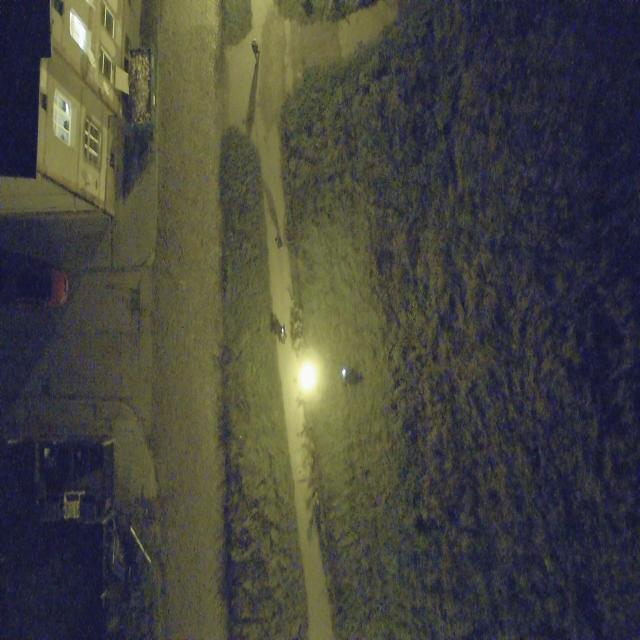


image 1/1 /content/dataset/valid/images/140CGOET_YUN00081_jpg.rf.440a0c8cc8340a97a4e79ff691e210a5.jpg: 640x640 3 persons, 16.4ms
Speed: 3.1ms preprocess, 16.4ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


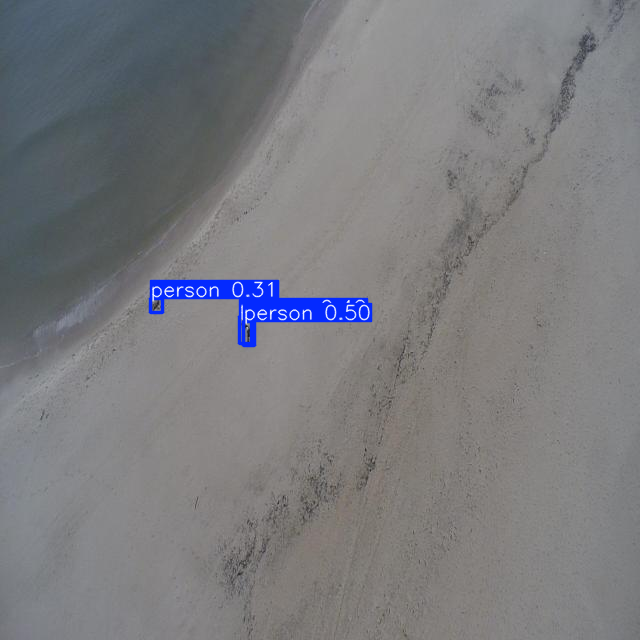


image 1/1 /content/dataset/valid/images/134CGOET_YUN00020_jpg.rf.375112ffb9b4c7490998ae16d45efb2e.jpg: 640x640 1 person, 2 vehicles, 16.3ms
Speed: 5.1ms preprocess, 16.3ms inference, 5.7ms postprocess per image at shape (1, 3, 640, 640)


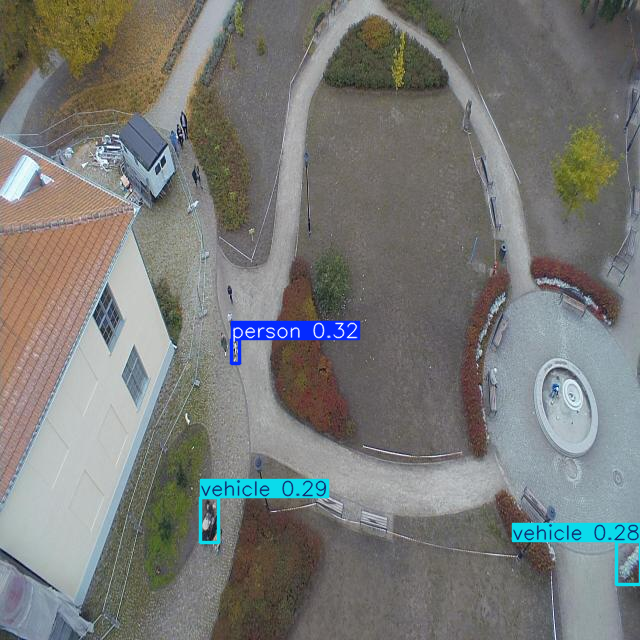


image 1/1 /content/dataset/valid/images/130CGOET_YUN00096_jpg.rf.b20dbb7aa5995b55a6106120a3f6016d.jpg: 640x640 1 vehicle, 17.6ms
Speed: 2.4ms preprocess, 17.6ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


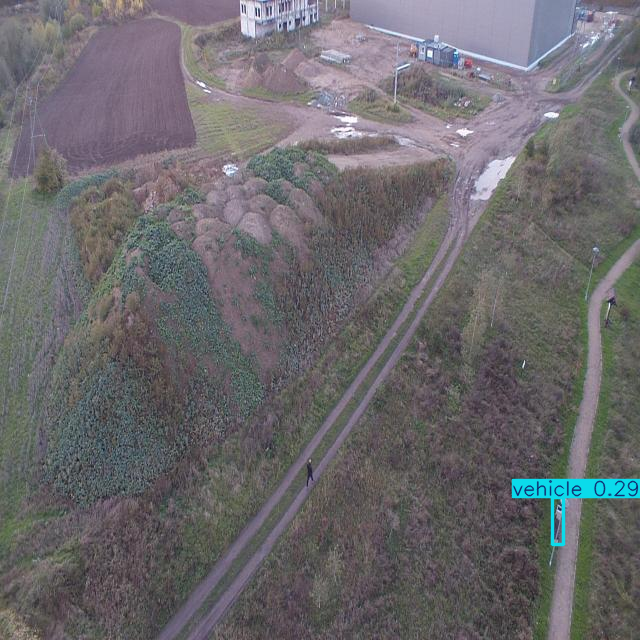


image 1/1 /content/dataset/valid/images/frame_003976_jpg.rf.ca1068b0a24e8d84b1bfe1c7e7bc75d9.jpg: 640x640 3 vehicles, 20.3ms
Speed: 2.4ms preprocess, 20.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


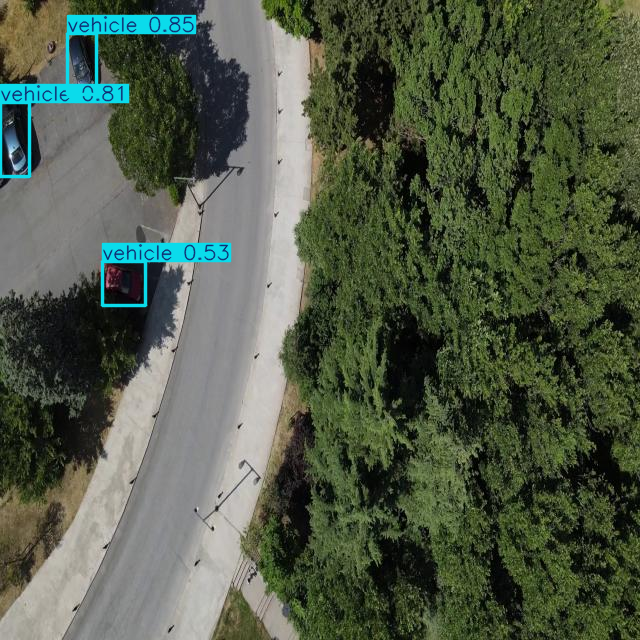


image 1/1 /content/dataset/valid/images/140CGOET_YUN00040_jpg.rf.75060b4beeeaae3c348e53b25fbd81bf.jpg: 640x640 4 persons, 16.9ms
Speed: 2.6ms preprocess, 16.9ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


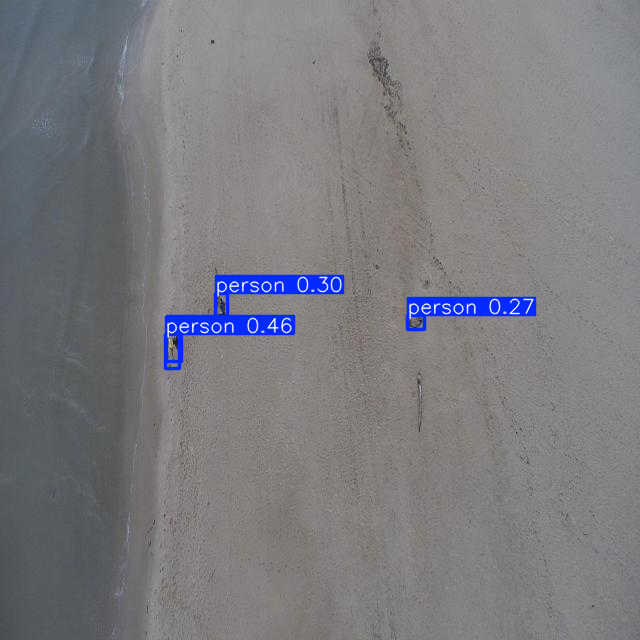


image 1/1 /content/dataset/valid/images/135CGOET_YUN00017_jpg.rf.ee550bcc388f09569c1bf503ffe67a7d.jpg: 640x640 (no detections), 16.4ms
Speed: 5.8ms preprocess, 16.4ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


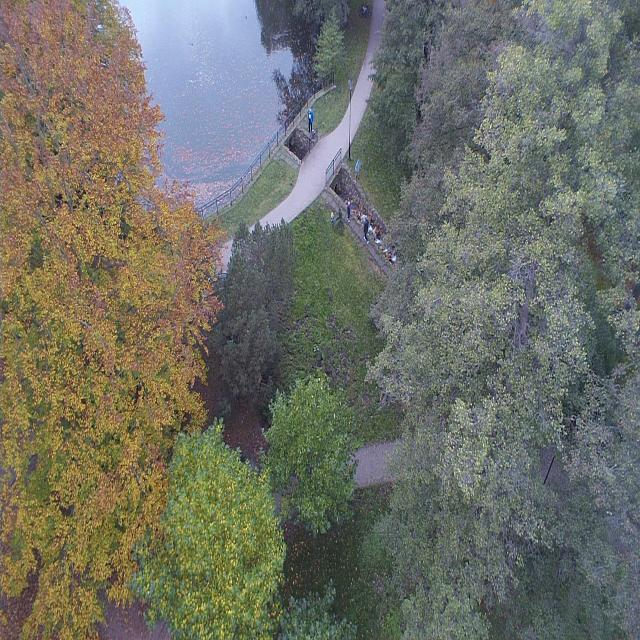


image 1/1 /content/dataset/valid/images/140CGOET_YUN00025_jpg.rf.e6a5d044d6e0035244da07ad2d1be2ca.jpg: 640x640 2 persons, 18.2ms
Speed: 2.6ms preprocess, 18.2ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


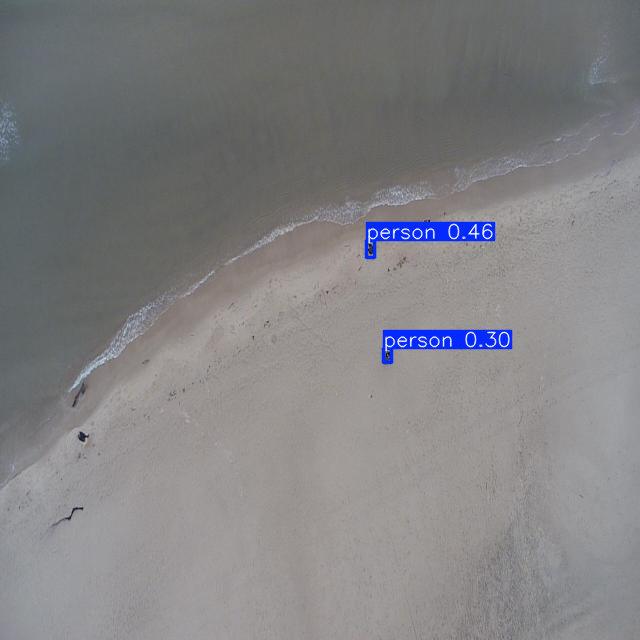


image 1/1 /content/dataset/valid/images/frame_002156_jpg.rf.e3dbaf0efae8b1a6dac101e025599b0b.jpg: 640x640 (no detections), 16.4ms
Speed: 2.6ms preprocess, 16.4ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


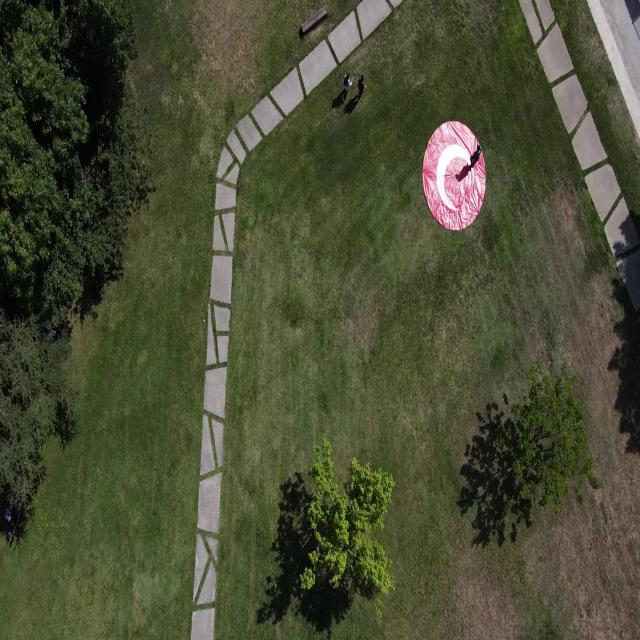


image 1/1 /content/dataset/valid/images/141CGOET_YUN00067_jpg.rf.d9c7f964a2758e7f2be47cb5c9bd1da7.jpg: 640x640 4 persons, 19.0ms
Speed: 2.5ms preprocess, 19.0ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


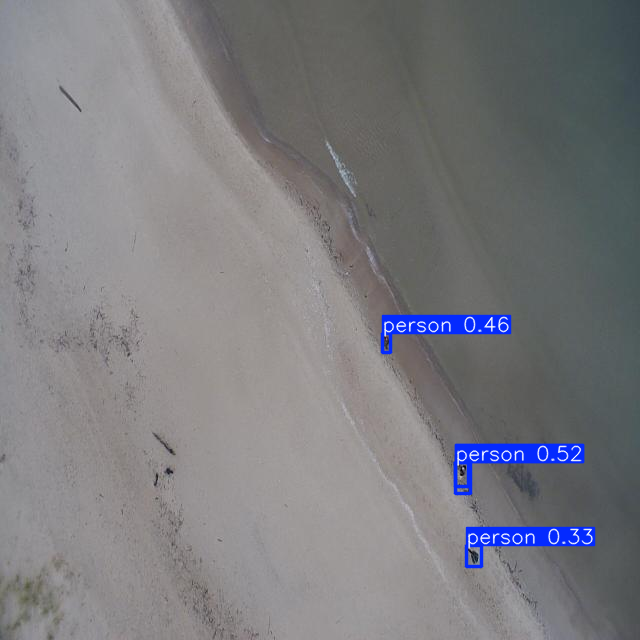

In [43]:
import os
import random
from PIL import Image
import matplotlib.pyplot as plt

# Path to your validation images folder
val_images_dir = '/content/dataset/valid/images'

# List image files
image_files = [f for f in os.listdir(val_images_dir) if f.endswith(('.jpg', '.png', '.jpeg'))]

# Randomly pick 10 images
random_images = random.sample(image_files, 10)

# Full paths
random_image_paths = [os.path.join(val_images_dir, fname) for fname in random_images]


# Load the trained model (best.pt should be saved in your run folder)
model = YOLO('./runs/yolo_person_vehicle/weights/best.pt')

# Run predictions and visualize
for path in random_image_paths:
    results = model(path)  # returns a list of Results objects

    # Show prediction
    results[0].show()  # This opens image with bboxes


## Descargo pesos automáticamente

In [ ]:
print(eval_period)

In [ ]:
weights = [el for el in os.listdir('output') if el.startswith('model') and el.endswith('.pth')]
print(weights)
# download 5 last weights

In [ ]:
from google.colab import files
# save best models
output_dir = cfg.OUTPUT_DIR

best_model_person = f"model_best_person_{run_id}.pth"
best_model_vehicle = f"model_best_vehicle_{run_id}.pth"
files.download(f"{output_dir}/{best_model_person}")
files.download(f"{output_dir}/{best_model_vehicle}")

In [ ]:
# save last
import shutil
new_filename = f"model_final_{run_id}.pth"
shutil.copy(f"{output_dir}/model_final.pth", f"{output_dir}/{new_filename}")
files.download(f"{output_dir}/{new_filename}")

In [44]:
%load_ext tensorboard

In [52]:
!apt install tree

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following NEW packages will be installed:
  tree
0 upgraded, 1 newly installed, 0 to remove and 34 not upgraded.
Need to get 47.9 kB of archives.
After this operation, 116 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tree amd64 2.0.2-1 [47.9 kB]
Fetched 47.9 kB in 0s (177 kB/s)
Selecting previously unselected package tree.
(Reading database ... 126332 files and directories currently installed.)
Preparing to unpack .../tree_2.0.2-1_amd64.deb ...
Unpacking tree (2.0.2-1) ...
Setting up tree (2.0.2-1) ...
Processing triggers for man-db (2.10.2-1) ...


In [53]:
!tree /content/runs/yolo_person_vehicle/

/content/runs/yolo_person_vehicle/
├── args.yaml
├── confusion_matrix_normalized.png
├── confusion_matrix.png
├── F1_curve.png
├── labels_correlogram.jpg
├── labels.jpg
├── P_curve.png
├── PR_curve.png
├── R_curve.png
├── results.csv
├── results.png
├── train_batch0.jpg
├── train_batch1.jpg
├── train_batch2.jpg
├── train_batch6480.jpg
├── train_batch6481.jpg
├── train_batch6482.jpg
├── val_batch0_labels.jpg
├── val_batch0_pred.jpg
├── val_batch1_labels.jpg
├── val_batch1_pred.jpg
├── val_batch2_labels.jpg
├── val_batch2_pred.jpg
└── weights
    ├── best.pt
    └── last.pt

1 directory, 25 files


In [48]:
%tensorboard --logdir runs/yolo_person_vehicle/train

<IPython.core.display.Javascript object>

In [ ]:
%tensorboard --logdir {repo_path}/runs